In [ ]:
import os
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from IPython.display import Image, display
from ultralytics import YOLO
import yaml

## Конфигурация 

In [94]:
class Config:
    DATASET_DIR = "dataset"
    ANNOT_FILE = "_annotations.csv"
    MODEL_NAME = "yolov8n.pt"
    IMG_SIZE = 640
    EPOCHS = 100
    BATCH = 4
    DEVICE = "cuda:1"
    TEST_SIZE = 0.2 
    
    AUGMENTATIONS = {
        'hsv_h': 0.015,
        'hsv_s': 0.7,
        'hsv_v': 0.4,
        'translate': 0.1,
        'scale': 0.5,
        'fliplr': 0.5,
        'mosaic': 1.0,
        'mixup': 0.1
    }

## Загрузка и подготовка данных

In [96]:
def prepare_data():
    # Создание структуры папок
    os.makedirs("yolo_dataset/images/train", exist_ok=True)
    os.makedirs("yolo_dataset/images/val", exist_ok=True)
    os.makedirs("yolo_dataset/images/test", exist_ok=True)
    os.makedirs("yolo_dataset/labels/train", exist_ok=True)
    os.makedirs("yolo_dataset/labels/val", exist_ok=True)
    os.makedirs("yolo_dataset/labels/test", exist_ok=True)

    # Загрузка аннотаций
    df = pd.read_csv(Config.ANNOT_FILE)
    
    train_files, temp_files = train_test_split(
        df["filename"].unique(),
        test_size=Config.TEST_SIZE*2, 
        random_state=42
    )
    val_files, test_files = train_test_split(
        temp_files,
        test_size=0.5, 
        random_state=42
    )
    
    # Функция конвертации в YOLO формат
    def convert_to_yolo(row):
        x_center = (row["xmin"] + row["xmax"]) / 2 / row["width"]
        y_center = (row["ymin"] + row["ymax"]) / 2 / row["height"]
        width = (row["xmax"] - row["xmin"]) / row["width"]
        height = (row["ymax"] - row["ymin"]) / row["height"]
        return f"0 {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}"
    
    # Обработка файлов
    for split, files in [("train", train_files), ("val", val_files), ("test", test_files)]:
        for file in files:
            img_path = os.path.join(Config.DATASET_DIR, file)
            if os.path.exists(img_path):
                img = cv2.imread(img_path)
                cv2.imwrite(f"yolo_dataset/images/{split}/{file}", img)
                
                with open(f"yolo_dataset/labels/{split}/{file.replace('.jpg', '.txt')}", "w") as f:
                    for _, row in df[df["filename"] == file].iterrows():
                        f.write(convert_to_yolo(row) + "\n")
    
    # Создание YAML
    yaml_content = {
        'path': os.path.abspath("yolo_dataset"),
        'train': 'images/train',
        'val': 'images/val',
        'test': 'images/test', 
        'names': {0: 'human'},
        'augment': Config.AUGMENTATIONS
    }
    
    with open("yolo_dataset/dataset.yaml", "w") as f:
        yaml.dump(yaml_content, f)

    print(f"Данные подготовлены. Распределение:")
    print(f"- Train: {len(train_files)} изображений")
    print(f"- Val: {len(val_files)} изображений")
    print(f"- Test: {len(test_files)} изображений")

prepare_data()

Данные подготовлены. Распределение:
- Train: 591 изображений
- Val: 197 изображений
- Test: 197 изображений


## Обучение

In [97]:
def train_model():
    model = YOLO(Config.MODEL_NAME)
    
    results = model.train(
        data="yolo_dataset/dataset.yaml",
        epochs=Config.EPOCHS,
        batch=Config.BATCH,
        imgsz=Config.IMG_SIZE,
        device=Config.DEVICE,
        augment=True,
        plots=True,
        verbose=True
    )
    return model

model = train_model()

New https://pypi.org/project/ultralytics/8.3.141 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.134 🚀 Python-3.10.12 torch-2.6.0+cu124 CUDA:1 (Tesla V100-SXM2-32GB, 32494MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=4, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=yolo_dataset/dataset.yaml, degrees=0.0, deterministic=True, device=1, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train5, nbs=64, nms=False, opset=None, optimiz

train: Scanning /home/v.chernodolya/introduction_to_ai/heridal/yolo_dataset/labels/train.cache... 788 images, 0 backgrounds, 0 corrupt: 100%|██████████| 788/788 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2358.0±1824.2 MB/s, size: 5469.1 KB)


val: Scanning /home/v.chernodolya/introduction_to_ai/heridal/yolo_dataset/labels/val... 303 images, 0 backgrounds, 0 corrupt: 100%|██████████| 303/303 [00:00<00:00, 954.35it/s]

val: New cache created: /home/v.chernodolya/introduction_to_ai/heridal/yolo_dataset/labels/val.cache


Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train5
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.12G      2.969      7.487       1.04         10        640: 100%|██████████| 197/197 [00:17<00:00, 11.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 13.74it/s]

                   all        303        934      0.439      0.379      0.316     0.0958



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      1.12G       2.92       4.26      1.009          8        640: 100%|██████████| 197/197 [00:16<00:00, 12.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 20.47it/s]


                   all        303        934      0.426      0.403      0.315     0.0859

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      1.12G      2.871      3.295     0.9766         28        640: 100%|██████████| 197/197 [00:15<00:00, 12.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 13.35it/s]

                   all        303        934      0.469      0.378      0.356      0.101



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      1.12G      2.848       2.85     0.9863          7        640: 100%|██████████| 197/197 [00:16<00:00, 12.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 14.90it/s]


                   all        303        934      0.428      0.389       0.33     0.0963

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      1.12G      2.809      2.507     0.9674         15        640: 100%|██████████| 197/197 [00:16<00:00, 11.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 14.94it/s]

                   all        303        934      0.468      0.475      0.377      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.14G      2.792      2.324     0.9594         22        640: 100%|██████████| 197/197 [00:16<00:00, 11.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 14.94it/s]

                   all        303        934      0.469      0.467      0.393       0.12



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      1.14G      2.722      2.113     0.9567          5        640: 100%|██████████| 197/197 [00:15<00:00, 12.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 21.73it/s]

                   all        303        934       0.47      0.456       0.42       0.14



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      1.14G       2.72      1.934     0.9561         28        640: 100%|██████████| 197/197 [00:16<00:00, 12.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 20.84it/s]


                   all        303        934      0.513      0.484      0.437      0.138

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      1.14G      2.675      1.863     0.9546         35        640: 100%|██████████| 197/197 [00:16<00:00, 12.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.46it/s]

                   all        303        934      0.487      0.482      0.433      0.137



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      1.14G      2.658      1.877       0.95         24        640: 100%|██████████| 197/197 [00:16<00:00, 11.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 14.67it/s]

                   all        303        934      0.495      0.509      0.437      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      1.14G       2.68      1.831     0.9456          6        640: 100%|██████████| 197/197 [00:16<00:00, 11.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 14.74it/s]

                   all        303        934      0.557      0.485      0.476      0.152



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      1.14G      2.601      1.714     0.9472          8        640: 100%|██████████| 197/197 [00:16<00:00, 11.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 21.82it/s]

                   all        303        934      0.505      0.507      0.471      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      1.14G      2.623      1.804     0.9379         31        640: 100%|██████████| 197/197 [00:15<00:00, 12.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.16it/s]

                   all        303        934      0.514      0.478      0.464      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      1.14G      2.571      1.682     0.9381         15        640: 100%|██████████| 197/197 [00:16<00:00, 12.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.06it/s]

                   all        303        934      0.535      0.503      0.495      0.176



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.14G      2.552       1.72     0.9311         20        640: 100%|██████████| 197/197 [00:16<00:00, 12.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.54it/s]

                   all        303        934      0.529      0.474       0.48      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      1.14G      2.485      1.678     0.9188         28        640: 100%|██████████| 197/197 [00:17<00:00, 11.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 21.22it/s]

                   all        303        934      0.581      0.523      0.534      0.196



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.14G      2.573      1.697     0.9368          9        640: 100%|██████████| 197/197 [00:16<00:00, 12.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 16.40it/s]

                   all        303        934      0.552      0.558      0.521       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.14G      2.576      1.657     0.9306          6        640: 100%|██████████| 197/197 [00:14<00:00, 13.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.54it/s]


                   all        303        934      0.573      0.526      0.517      0.183

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      1.14G      2.503      1.596      0.919         18        640: 100%|██████████| 197/197 [00:16<00:00, 12.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.62it/s]

                   all        303        934      0.567      0.547      0.535      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      1.14G       2.48      1.631     0.9252         17        640: 100%|██████████| 197/197 [00:16<00:00, 12.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.47it/s]

                   all        303        934       0.59      0.561      0.549      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      1.14G      2.498      1.581     0.9194         11        640: 100%|██████████| 197/197 [00:15<00:00, 12.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 16.80it/s]

                   all        303        934      0.619      0.549      0.563      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      1.14G      2.496      1.629      0.921         21        640: 100%|██████████| 197/197 [00:16<00:00, 12.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.23it/s]

                   all        303        934      0.575      0.546      0.557      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      1.14G      2.478      1.515     0.9177         11        640: 100%|██████████| 197/197 [00:13<00:00, 14.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.46it/s]

                   all        303        934      0.631      0.585      0.581      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      1.14G      2.421      1.572     0.9185         21        640: 100%|██████████| 197/197 [00:16<00:00, 11.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.08it/s]

                   all        303        934      0.587      0.543      0.544      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      1.14G      2.406      1.491     0.9143         11        640: 100%|██████████| 197/197 [00:15<00:00, 12.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 16.69it/s]


                   all        303        934      0.496       0.48      0.443      0.136

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      1.14G      2.411      1.487     0.9048         17        640: 100%|██████████| 197/197 [00:15<00:00, 12.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.82it/s]


                   all        303        934      0.591      0.576      0.553      0.198

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      1.14G      2.441      1.501     0.9266         28        640: 100%|██████████| 197/197 [00:16<00:00, 12.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.34it/s]

                   all        303        934       0.58      0.541      0.535      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      1.14G      2.447      1.557     0.9123         16        640: 100%|██████████| 197/197 [00:14<00:00, 13.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 25.43it/s]

                   all        303        934      0.569      0.466       0.49      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      1.14G      2.374      1.431     0.9186          6        640: 100%|██████████| 197/197 [00:16<00:00, 11.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.46it/s]

                   all        303        934      0.538      0.544      0.534      0.185



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      1.14G      2.513       1.53     0.9067         13        640: 100%|██████████| 197/197 [00:16<00:00, 12.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.34it/s]

                   all        303        934      0.565      0.524      0.519      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      1.14G      2.445      1.457     0.9032         32        640: 100%|██████████| 197/197 [00:16<00:00, 12.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.35it/s]

                   all        303        934      0.595      0.605      0.579      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      1.14G      2.362       1.41      0.906         11        640: 100%|██████████| 197/197 [00:16<00:00, 12.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.37it/s]

                   all        303        934       0.58       0.56      0.565      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      1.14G      2.357      1.421     0.9058         15        640: 100%|██████████| 197/197 [00:16<00:00, 12.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 25.83it/s]

                   all        303        934      0.639      0.575      0.616      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      1.14G      2.432      1.456     0.9055         23        640: 100%|██████████| 197/197 [00:14<00:00, 13.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.56it/s]


                   all        303        934      0.601      0.499      0.539      0.191

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      1.14G      2.422      1.423      0.913         13        640: 100%|██████████| 197/197 [00:15<00:00, 12.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.67it/s]

                   all        303        934      0.684      0.569      0.615      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      1.14G      2.344      1.407     0.9047         23        640: 100%|██████████| 197/197 [00:14<00:00, 13.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.65it/s]

                   all        303        934      0.648      0.575      0.607       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      1.14G      2.313      1.386      0.898         10        640: 100%|██████████| 197/197 [00:14<00:00, 13.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 21.18it/s]

                   all        303        934      0.577      0.513      0.541      0.192



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      1.14G      2.296      1.369     0.8923         11        640: 100%|██████████| 197/197 [00:14<00:00, 13.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.53it/s]

                   all        303        934      0.589      0.562      0.577      0.222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      1.14G      2.269      1.343     0.9117          6        640: 100%|██████████| 197/197 [00:14<00:00, 13.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 21.09it/s]

                   all        303        934       0.64       0.59      0.627      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      1.14G       2.32      1.381     0.8967         23        640: 100%|██████████| 197/197 [00:15<00:00, 12.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.53it/s]

                   all        303        934      0.632      0.601      0.611      0.232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      1.14G      2.307       1.38     0.9008         25        640: 100%|██████████| 197/197 [00:15<00:00, 12.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.55it/s]


                   all        303        934      0.625      0.586      0.595      0.222

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      1.14G       2.29      1.336     0.8959          9        640: 100%|██████████| 197/197 [00:15<00:00, 12.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.36it/s]

                   all        303        934      0.646      0.575       0.62      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      1.14G      2.303      1.327     0.8952         16        640: 100%|██████████| 197/197 [00:15<00:00, 12.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 21.23it/s]

                   all        303        934      0.652      0.525      0.569      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      1.14G      2.292      1.358     0.8941         39        640: 100%|██████████| 197/197 [00:15<00:00, 12.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 22.97it/s]

                   all        303        934      0.604       0.56      0.571      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      1.14G      2.288      1.344     0.8906         17        640: 100%|██████████| 197/197 [00:14<00:00, 13.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 21.56it/s]

                   all        303        934      0.663      0.582      0.632      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      1.14G      2.286      1.289     0.8904         16        640: 100%|██████████| 197/197 [00:15<00:00, 12.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.77it/s]

                   all        303        934      0.663      0.592      0.643      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      1.14G      2.284      1.368     0.8952         26        640: 100%|██████████| 197/197 [00:16<00:00, 12.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.59it/s]


                   all        303        934      0.621      0.618       0.63      0.243

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      1.14G      2.239      1.314     0.8881         17        640: 100%|██████████| 197/197 [00:16<00:00, 12.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.44it/s]

                   all        303        934      0.635      0.618      0.644       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      1.14G      2.187      1.318     0.8857         32        640: 100%|██████████| 197/197 [00:15<00:00, 12.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 25.72it/s]

                   all        303        934       0.66      0.634      0.659      0.255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      1.14G      2.252      1.315     0.8972         21        640: 100%|██████████| 197/197 [00:14<00:00, 13.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.61it/s]

                   all        303        934      0.661       0.64      0.662      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      1.14G      2.223      1.279     0.8864         15        640: 100%|██████████| 197/197 [00:15<00:00, 12.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.75it/s]

                   all        303        934      0.625      0.591      0.622      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      1.14G       2.23      1.305     0.8859         20        640: 100%|██████████| 197/197 [00:16<00:00, 12.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.60it/s]

                   all        303        934      0.673      0.605      0.647      0.268



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      1.14G       2.21      1.302     0.8902         13        640: 100%|██████████| 197/197 [00:15<00:00, 12.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 25.05it/s]

                   all        303        934      0.637      0.595      0.637      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      1.14G      2.215       1.27     0.8776         12        640: 100%|██████████| 197/197 [00:15<00:00, 12.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.47it/s]

                   all        303        934      0.679      0.634      0.668       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      1.14G      2.217      1.232     0.8913         10        640: 100%|██████████| 197/197 [00:14<00:00, 13.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.60it/s]

                   all        303        934      0.617      0.623      0.637      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      1.14G      2.202      1.303     0.8824          8        640: 100%|██████████| 197/197 [00:15<00:00, 12.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.61it/s]

                   all        303        934      0.637      0.623      0.654      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      1.14G      2.231      1.253     0.8812          9        640: 100%|██████████| 197/197 [00:15<00:00, 13.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 16.69it/s]

                   all        303        934      0.634      0.553      0.591      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      1.14G      2.215      1.258     0.8875         25        640: 100%|██████████| 197/197 [00:16<00:00, 12.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.41it/s]

                   all        303        934      0.699      0.604      0.673      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      1.14G       2.16      1.267     0.8758         10        640: 100%|██████████| 197/197 [00:15<00:00, 12.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.70it/s]


                   all        303        934      0.654      0.605      0.627      0.245

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      1.14G      2.179      1.275     0.8837         30        640: 100%|██████████| 197/197 [00:16<00:00, 12.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 24.31it/s]

                   all        303        934      0.656      0.635      0.662      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      1.14G      2.186      1.232     0.8918         23        640: 100%|██████████| 197/197 [00:15<00:00, 12.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 20.58it/s]

                   all        303        934      0.665      0.607      0.642      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      1.14G      2.133      1.201     0.8783         34        640: 100%|██████████| 197/197 [00:15<00:00, 12.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.53it/s]

                   all        303        934      0.682       0.65      0.679       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      1.14G      2.128      1.204     0.8794         17        640: 100%|██████████| 197/197 [00:15<00:00, 12.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.52it/s]

                   all        303        934      0.631      0.618      0.635      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      1.14G      2.124      1.232     0.8768          6        640: 100%|██████████| 197/197 [00:16<00:00, 12.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 17.55it/s]

                   all        303        934      0.695       0.67      0.692      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      1.14G      2.125       1.22     0.8699         20        640: 100%|██████████| 197/197 [00:16<00:00, 11.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 21.44it/s]

                   all        303        934      0.645       0.62      0.644      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      1.14G      2.157      1.252     0.8832         32        640: 100%|██████████| 197/197 [00:14<00:00, 13.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.63it/s]

                   all        303        934       0.69      0.621      0.671      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      1.14G      2.189      1.181     0.8728         25        640: 100%|██████████| 197/197 [00:16<00:00, 11.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 21.23it/s]

                   all        303        934      0.704      0.616      0.673      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      1.14G      2.137      1.196     0.8737         14        640: 100%|██████████| 197/197 [00:15<00:00, 12.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.54it/s]

                   all        303        934      0.632      0.539      0.578      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      1.14G      2.157      1.213      0.873         55        640: 100%|██████████| 197/197 [00:16<00:00, 12.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.51it/s]

                   all        303        934       0.68      0.625      0.662      0.271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      1.14G      2.119       1.23     0.8792         30        640: 100%|██████████| 197/197 [00:15<00:00, 12.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.85it/s]


                   all        303        934      0.686      0.616      0.659      0.263

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      1.14G      2.119      1.223     0.8696         21        640: 100%|██████████| 197/197 [00:14<00:00, 13.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 20.75it/s]

                   all        303        934      0.695       0.63      0.669      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      1.14G      2.111      1.185     0.8765         26        640: 100%|██████████| 197/197 [00:16<00:00, 12.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.81it/s]


                   all        303        934      0.703      0.617      0.674      0.279

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      1.14G      2.109      1.195     0.8762          7        640: 100%|██████████| 197/197 [00:15<00:00, 12.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 17.59it/s]

                   all        303        934      0.681       0.61      0.657      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      1.14G      2.093      1.212     0.8731         23        640: 100%|██████████| 197/197 [00:15<00:00, 13.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.94it/s]


                   all        303        934      0.673      0.605       0.65      0.258

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      1.14G      2.082      1.145      0.867         24        640: 100%|██████████| 197/197 [00:15<00:00, 12.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.70it/s]

                   all        303        934      0.695       0.66      0.688      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      1.14G      2.064      1.097     0.8698         13        640: 100%|██████████| 197/197 [00:15<00:00, 12.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.60it/s]

                   all        303        934      0.675      0.637      0.659      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      1.14G      2.076      1.105     0.8647         21        640: 100%|██████████| 197/197 [00:13<00:00, 14.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 16.14it/s]


                   all        303        934      0.678      0.627      0.668      0.276

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      1.14G       2.02      1.081     0.8691         25        640: 100%|██████████| 197/197 [00:16<00:00, 12.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 14.10it/s]

                   all        303        934      0.691      0.617      0.655      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      1.14G      2.067      1.129     0.8697         10        640: 100%|██████████| 197/197 [00:15<00:00, 12.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.57it/s]

                   all        303        934      0.724      0.622      0.688      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      1.14G      2.061      1.106     0.8693         21        640: 100%|██████████| 197/197 [00:15<00:00, 12.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.51it/s]

                   all        303        934      0.697      0.668      0.701      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      1.14G      2.065      1.121     0.8737         12        640: 100%|██████████| 197/197 [00:15<00:00, 12.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.71it/s]

                   all        303        934      0.699      0.628      0.669      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      1.14G      2.042      1.156     0.8704         18        640: 100%|██████████| 197/197 [00:14<00:00, 13.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 19.70it/s]

                   all        303        934      0.665      0.594      0.638      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      1.14G      2.039      1.101     0.8657         24        640: 100%|██████████| 197/197 [00:16<00:00, 12.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.50it/s]

                   all        303        934      0.757      0.612      0.706      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      1.14G      2.029      1.053     0.8584         29        640: 100%|██████████| 197/197 [00:16<00:00, 12.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.42it/s]

                   all        303        934      0.764        0.6      0.701      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      1.14G      2.021      1.053     0.8656         13        640: 100%|██████████| 197/197 [00:15<00:00, 12.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.67it/s]

                   all        303        934      0.691      0.618      0.669      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      1.14G      2.018      1.055     0.8584         15        640: 100%|██████████| 197/197 [00:16<00:00, 12.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 18.18it/s]

                   all        303        934      0.726      0.622      0.688      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      1.14G       2.02      1.055     0.8614          5        640: 100%|██████████| 197/197 [00:15<00:00, 12.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 23.99it/s]

                   all        303        934      0.684      0.605      0.657      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      1.14G      1.993       1.02     0.8659         18        640: 100%|██████████| 197/197 [00:14<00:00, 13.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 19.89it/s]

                   all        303        934      0.715      0.648      0.699      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      1.14G      1.997      1.052     0.8625         16        640: 100%|██████████| 197/197 [00:15<00:00, 12.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 14.14it/s]


                   all        303        934      0.707      0.635        0.7      0.289

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      1.14G      1.976      1.036     0.8655         13        640: 100%|██████████| 197/197 [00:15<00:00, 12.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.62it/s]

                   all        303        934      0.675      0.637      0.688      0.285


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      1.14G      1.953      1.051     0.8692         11        640: 100%|██████████| 197/197 [00:16<00:00, 12.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.94it/s]

                   all        303        934      0.691      0.616       0.67      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      1.14G       1.93       1.02     0.8627         11        640: 100%|██████████| 197/197 [00:16<00:00, 11.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.76it/s]

                   all        303        934      0.696      0.601      0.658       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      1.14G      1.924      1.059     0.8611         36        640: 100%|██████████| 197/197 [00:14<00:00, 13.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.54it/s]

                   all        303        934       0.77      0.622      0.721      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      1.14G      1.934      1.061      0.868          5        640: 100%|██████████| 197/197 [00:15<00:00, 12.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 17.41it/s]

                   all        303        934      0.782      0.607      0.715      0.304



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      1.14G      1.882     0.9942     0.8519          9        640: 100%|██████████| 197/197 [00:16<00:00, 11.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.32it/s]

                   all        303        934       0.79      0.601       0.71      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      1.14G      1.936      1.085     0.8593         25        640: 100%|██████████| 197/197 [00:16<00:00, 12.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.61it/s]

                   all        303        934      0.734      0.642      0.721      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      1.14G      1.898      1.002     0.8611         11        640: 100%|██████████| 197/197 [00:16<00:00, 12.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 20.50it/s]

                   all        303        934      0.718      0.652      0.711      0.294



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      1.14G       1.91      1.023     0.8581         17        640: 100%|██████████| 197/197 [00:15<00:00, 12.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 25.45it/s]


                   all        303        934      0.737      0.645      0.715      0.306

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      1.14G       1.85     0.9579     0.8584         12        640: 100%|██████████| 197/197 [00:16<00:00, 12.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:01<00:00, 25.40it/s]

                   all        303        934      0.737      0.627      0.712      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      1.14G      1.856      1.001       0.86          9        640: 100%|██████████| 197/197 [00:15<00:00, 12.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:02<00:00, 15.25it/s]

                   all        303        934      0.748      0.632      0.712      0.299



100 epochs completed in 0.510 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 6.2MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics 8.3.134 🚀 Python-3.10.12 torch-2.6.0+cu124 CUDA:1 (Tesla V100-SXM2-32GB, 32494MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:03<00:00, 10.97it/s]


                   all        303        934      0.661      0.652      0.676      0.295
Speed: 0.3ms preprocess, 4.3ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/detect/train5


## Визуализация

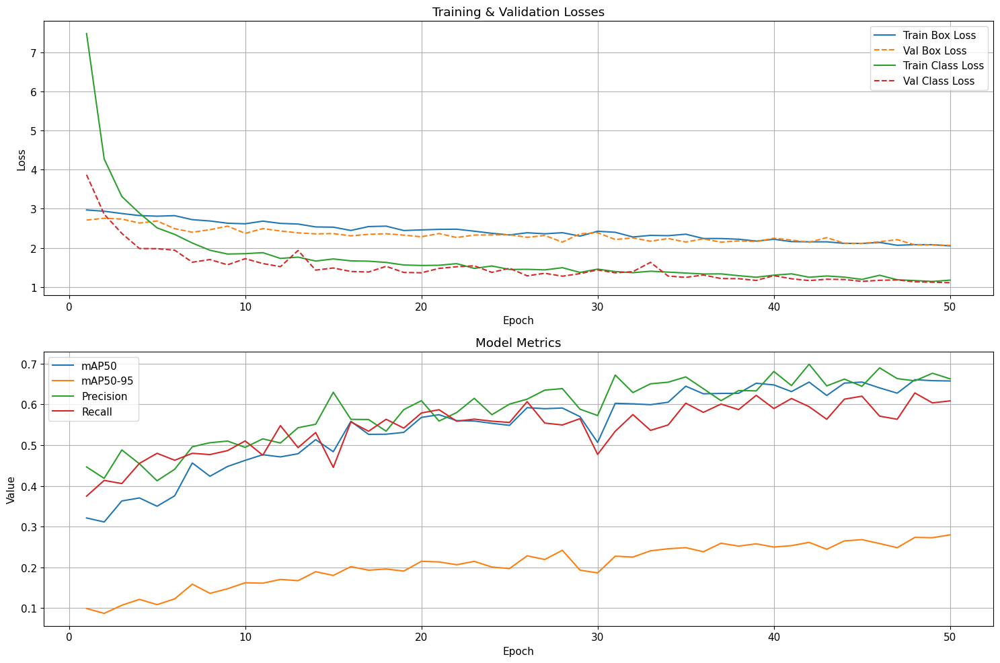

In [98]:
def plot_metrics():
    results_file = "runs/detect/train/results.csv"
    if not os.path.exists(results_file):
        print(f"⚠️ Файл с метриками не найден: {results_file}")
        return
    
    df = pd.read_csv(results_file)
    
    plt.figure(figsize=(15, 10))
    
    # График 1: Потери
    plt.subplot(2, 1, 1)
    plt.plot(df['epoch'], df['train/box_loss'], label='Train Box Loss')
    plt.plot(df['epoch'], df['val/box_loss'], label='Val Box Loss', linestyle='--')
    plt.plot(df['epoch'], df['train/cls_loss'], label='Train Class Loss')
    plt.plot(df['epoch'], df['val/cls_loss'], label='Val Class Loss', linestyle='--')
    plt.title('Training & Validation Losses')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    
    # График 2: Метрики качества
    plt.subplot(2, 1, 2)
    plt.plot(df['epoch'], df['metrics/mAP50(B)'], label='mAP50')
    plt.plot(df['epoch'], df['metrics/mAP50-95(B)'], label='mAP50-95')
    plt.plot(df['epoch'], df['metrics/precision(B)'], label='Precision')
    plt.plot(df['epoch'], df['metrics/recall(B)'], label='Recall')
    plt.title('Model Metrics')
    plt.xlabel('Epoch')
    plt.ylabel('Value')
    plt.legend()
    plt.grid(True)
    
    plt.tight_layout()
    plt.show()

plot_metrics()

## Валидация

In [104]:
def evaluate_model():
    print("\nРезультаты валидации:")
    val_metrics = model.val(split='val')  
    print(f"mAP50: {val_metrics.box.map50:.4f}")
    print(f"mAP50-95: {val_metrics.box.map:.4f}")
    
    print("\nРезультаты тестирования:")
    test_metrics = model.val(data="yolo_dataset/dataset.yaml", split='test')  
    print(f"Test mAP50: {test_metrics.box.map50:.4f}")
    print(f"Test mAP50-95: {test_metrics.box.map:.4f}")

evaluate_model()


Результаты валидации:
Ultralytics 8.3.134 🚀 Python-3.10.12 torch-2.6.0+cu124 CUDA:1 (Tesla V100-SXM2-32GB, 32494MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3922.0±526.5 MB/s, size: 5001.3 KB)


val: Scanning /home/v.chernodolya/introduction_to_ai/heridal/yolo_dataset/labels/val.cache... 303 images, 0 backgrounds, 0 corrupt: 100%|██████████| 303/303 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 76/76 [00:05<00:00, 14.22it/s]


                   all        303        934      0.672      0.653      0.683      0.298
Speed: 0.4ms preprocess, 6.6ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to runs/detect/train54
mAP50: 0.6830
mAP50-95: 0.2979

Результаты тестирования:
Ultralytics 8.3.134 🚀 Python-3.10.12 torch-2.6.0+cu124 CUDA:1 (Tesla V100-SXM2-32GB, 32494MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2606.4±915.3 MB/s, size: 4293.8 KB)


val: Scanning /home/v.chernodolya/introduction_to_ai/heridal/yolo_dataset/labels/test.cache... 197 images, 0 backgrounds, 0 corrupt: 100%|██████████| 197/197 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 50/50 [00:04<00:00, 11.07it/s]


                   all        197        564      0.675      0.661      0.683      0.311
Speed: 0.5ms preprocess, 6.6ms inference, 0.0ms loss, 2.9ms postprocess per image
Results saved to runs/detect/train55
Test mAP50: 0.6831
Test mAP50-95: 0.3108


## Пример детекции


image 1/1 /home/v.chernodolya/introduction_to_ai/heridal/yolo_dataset/images/test/train_BRK_2123_JPG.rf.b67602dd7054a47527b739791461a7bf.jpg: 480x640 2 humans, 37.3ms
Speed: 4.8ms preprocess, 37.3ms inference, 16.9ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict


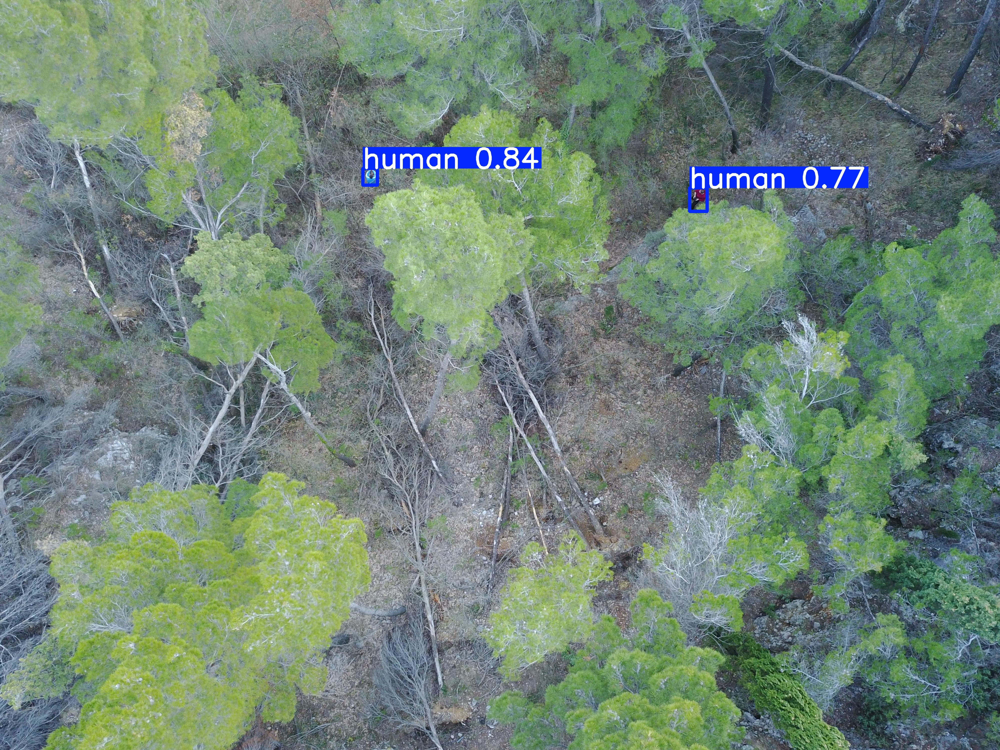


image 1/1 /home/v.chernodolya/introduction_to_ai/heridal/yolo_dataset/images/test/train_GOR_3002_JPG.rf.1f8cd89bb8cd6d07ea10dbacc08fe7e0.jpg: 480x640 1 human, 23.3ms
Speed: 6.2ms preprocess, 23.3ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict


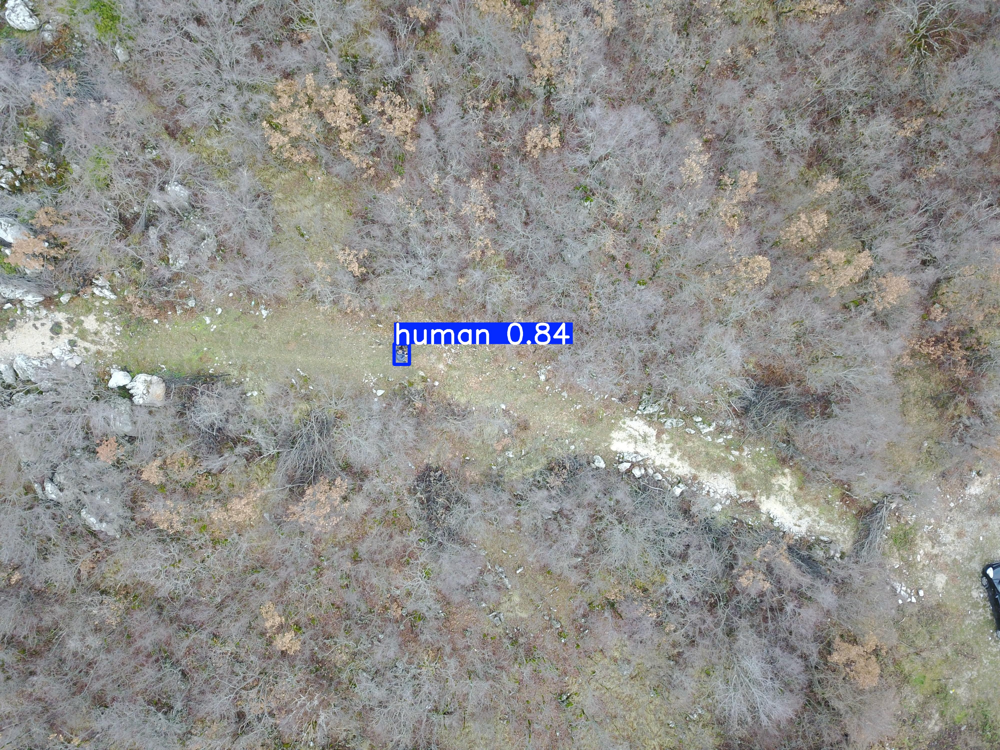


image 1/1 /home/v.chernodolya/introduction_to_ai/heridal/yolo_dataset/images/test/train_GOR_3068_JPG.rf.6f9026c8031cd033f231e86b990d017e.jpg: 480x640 2 humans, 17.2ms
Speed: 3.0ms preprocess, 17.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict


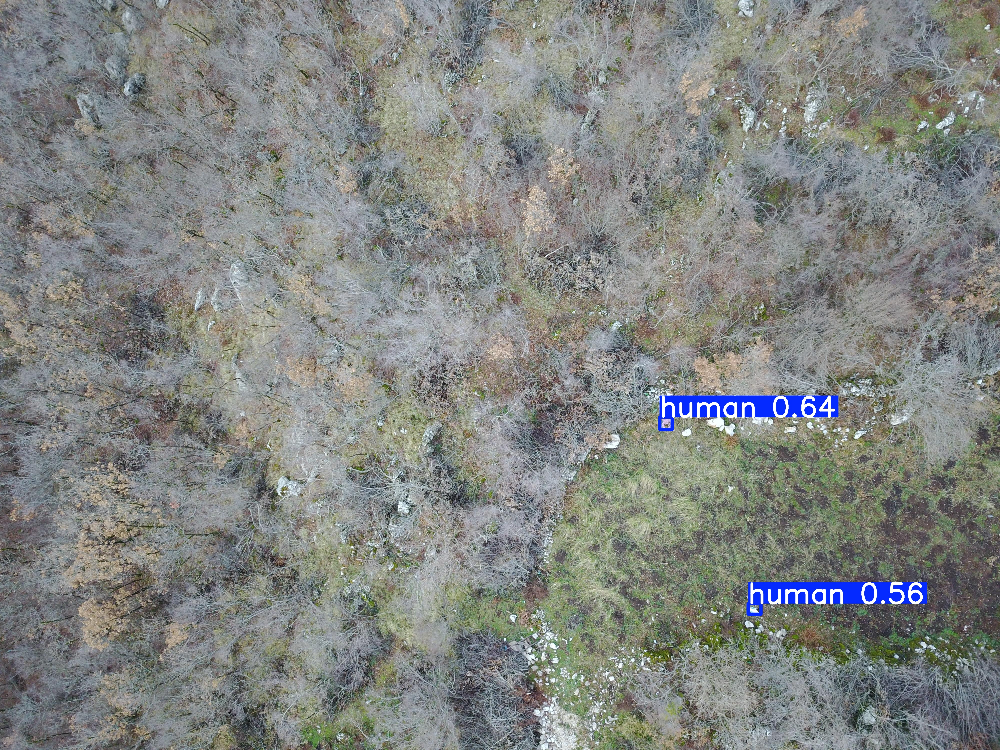

In [103]:
def show_detection_examples(n=3):
    test_images = [f for f in os.listdir("yolo_dataset/images/test") if f.lower().endswith(('.jpg', '.png', '.jpeg'))]
    
    if not test_images:
        print("В тестовой папке нет изображений")
        return
    
    selected_images = np.random.choice(test_images, min(n, len(test_images)), replace=False)
    
    for img_name in selected_images:
        img_path = os.path.join("yolo_dataset/images/test", img_name)
        results = model.predict(
            source=img_path,
            conf=0.5,
            save=True,
            project="runs/detect",
            name="predict",
            exist_ok=True
        )
        
        result_path = f"runs/detect/predict/{img_name}"
        if os.path.exists(result_path):
            display(Image(filename=result_path, width=800))
        else:
            print(f"Результат не найден: {result_path}")

show_detection_examples()


image 1/1 /home/v.chernodolya/introduction_to_ai/heridal/yolo_dataset/images/val/train_GOR_3003_JPG.rf.e36080ecfb5a41dd06d3bfa0fc45461e.jpg: 480x640 1 human, 16.4ms
Speed: 2.8ms preprocess, 16.4ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict


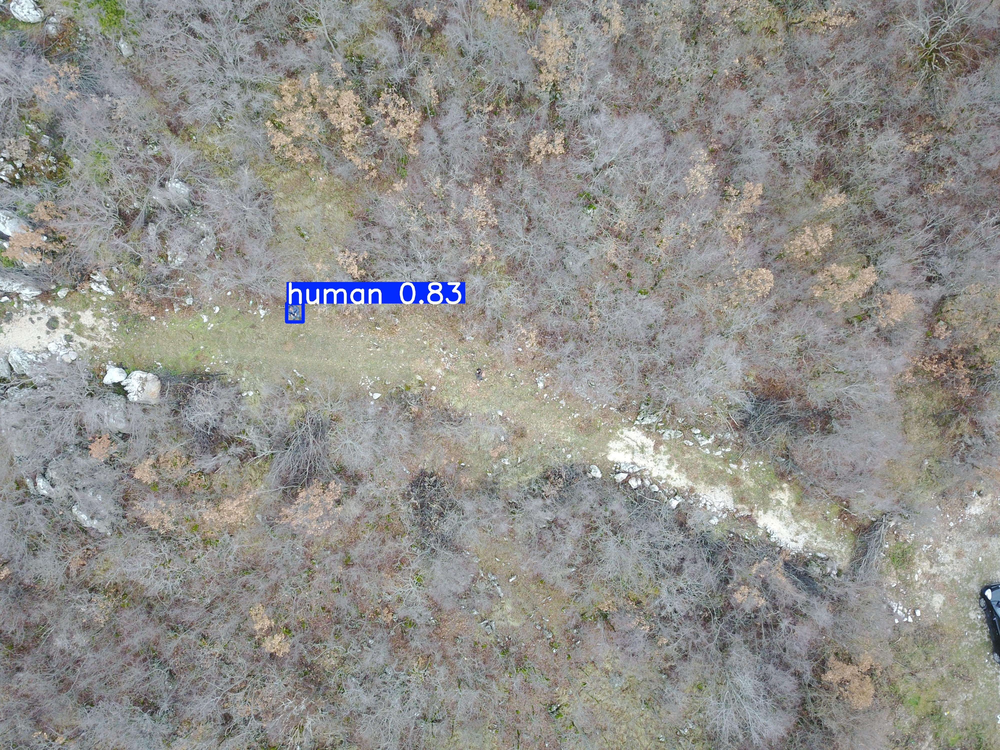

In [93]:
def run_detection():
    # Выбираем случайное изображение из валидационного набора
    import random
    val_images = [f for f in os.listdir("yolo_dataset/images/val") if f.endswith(('.jpg', '.png', '.jpeg'))]
    
    if not val_images:
        print("В валидационной папке нет изображений")
        return
    
    test_image = random.choice(val_images)
    test_image_path = os.path.join("yolo_dataset/images/val", test_image)
    
    # Выполняем детекцию
    results = model.predict(
        source=test_image_path,
        conf=0.5,
        save=True,
        project="runs/detect",
        name="predict",
        exist_ok=True
    )
    
    # Путь к сохраненному результату
    save_dir = "runs/detect/predict"
    result_image = os.path.join(save_dir, test_image)
    
    # Проверяем существование файла
    if os.path.exists(result_image):
        from IPython.display import Image, display
        display(Image(filename=result_image, width=800))
    else:
        print(f"Результат не найден по пути: {result_image}")

run_detection()